# 用WGAN方法GAN出更多天竺鼠車車圖片

產生圖片大小: 64x64


In [1]:
import torch
import torch.nn as nn
import torch.optim as optimizers
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
from torchvision.utils import make_grid
import random
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML, display
import ipywidgets as widgets

from wgan import NEPPDiscriminator, NEPPGenerator

manualSeed = 666
random.seed(manualSeed)
torch.manual_seed(manualSeed)

# from: https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


## 定義生成網路

In [2]:
g_net = NEPPGenerator().cuda()
g_net.apply(weights_init)
print(g_net)

NEPPGenerator(
  (net_stack): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh

## 定義評論網路

In [3]:
d_net = NEPPDiscriminator().cuda()
d_net.apply(weights_init)

NEPPDiscriminator(
  (net): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
)

## 準備訓練資料

In [4]:
puipui_imgs = ImageFolder(root='puipui', transform=transforms.Compose([
    transforms.Resize(64),
    transforms.CenterCrop(64),
    transforms.RandomHorizontalFlip(0.4),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
]))

print('number of images:', len(puipui_imgs.imgs))
# puipui_imgs[0][0]

number of images: 88


## 超參數

In [9]:
EPOCHS = 1000
BATCH_SIZE = 64
LR = 0.0001
C = 0.01
UPDATE_G_PER_EPOCH = 5

## 訓練

In [10]:
dataloader = DataLoader(puipui_imgs, batch_size=BATCH_SIZE, shuffle=True, num_workers=2)

g_optim = optimizers.RMSprop(g_net.parameters(), lr=LR)
d_optim = optimizers.RMSprop(d_net.parameters(), lr=LR)

Text(value='', layout=Layout(width='100%'))

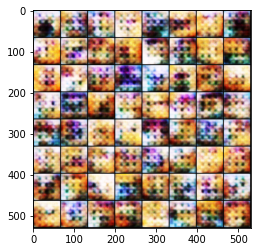

In [11]:
status = widgets.Text(layout={'width': '100%'})

generated = []
fixed_noise = torch.randn(64, 100, 1, 1).cuda()


display(status)
for epoch in range(1, EPOCHS+1):
    total_d_loss = 0
    total_g_loss = 0

    for i, batch in enumerate(dataloader):
        x = batch[0].cuda()
        x_size = x.size(0)
        random_noise = torch.randn(x_size, 100, 1, 1).cuda()

        # 用真和假的圖更新評論網路
        d_optim.zero_grad()
        
        # 真圖
        d_pred_real = d_net(x).view(-1)
        # 假圖
        fake_puipui = g_net(random_noise)
        d_pred_fake = d_net(fake_puipui.detach()).view(-1)

        d_loss = -torch.mean(d_pred_real) + torch.mean(d_pred_fake)
        d_loss.backward()
        d_optim.step()
        total_d_loss += d_loss.item()

        for p in d_net.parameters():
            p.data.clamp_(-C, C)

    # 更新生成網路
    if epoch % UPDATE_G_PER_EPOCH == 0:
        g_optim.zero_grad()
        d_pred = d_net(fake_puipui).view(-1)
        g_loss = -torch.mean(d_pred)
        g_loss.backward()
        g_optim.step()
        total_g_loss += g_loss.item()
        
        status.value = f'EPOCH: {epoch} | D loss: {total_d_loss} | G loss: {total_g_loss}'

        with torch.no_grad():
            generated_puipui = g_net(fixed_noise).detach().cpu()
            img = make_grid(generated_puipui, padding=2, normalize=True)
            generated.append(img)
        plt.imshow(np.transpose(img,(1,2,0)))


Animation size has reached 21376593 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


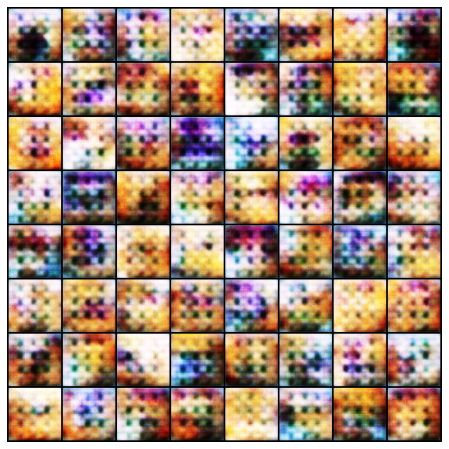

In [12]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in generated]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())